In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os 
import subprocess
import sys
import random
import gc

# pickle
import pickle

from src.hVOS.cell import Cell
from src.hVOS.morphology import Morphology
from src.hVOS.hvos_readout import hVOSReadout
from src.hVOS.vsd_readout import VSDReadout
from src.hVOS.camera import Camera
from src.hVOS.psf import PSF

c:\Users\jjudge3\Desktop\scratch\S1_Thal_NetPyNE_Frontiers_2022\src\hVOS\microscPSF.py:214: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  C, residuals, _, _ = numpy.linalg.lstsq(J.T, phase.T)


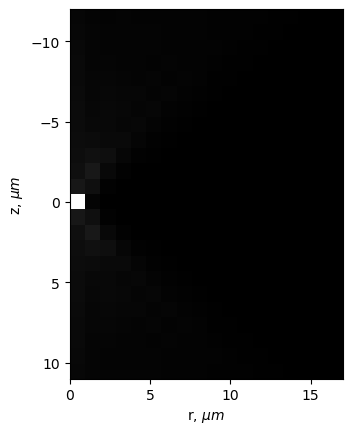

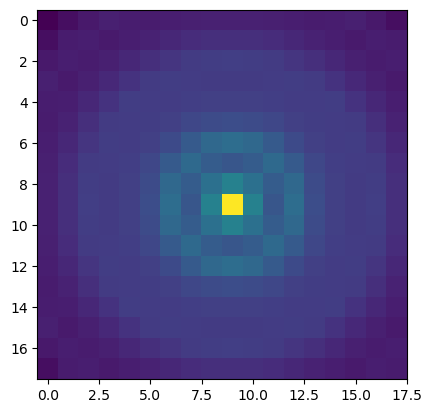

In [2]:
psf = PSF().build_3D_PSF()  # returns a 3D PSF, but shows the radial-axial profile
plt.imshow(psf[:, : , 0])  # show the radial profile
plt.show()

In [31]:
run_id = 1
target_hVOS_populations = ["L4_SS", "L4_PC"]
target_sparsity = 0.6
optical_type = "hVOS"
data_dir = 'C:/Users/jjudge3/Desktop/neuron docker/' # /path/to/compressed/data
modeL_rec_out_dir = data_dir + 'archive/run' + str(run_id) + "/model_rec/" # /path/to/NMC/cellNMLfiles
morphology_data_dir = 'C:/Users/jjudge3/Desktop/scratch/NMC_model/NMC.NeuronML2/' # /path/to/NMC/cellNMLfiles
overwrite_optical_data = False

In [ ]:
compart_data = {}
target_dir = data_dir + 'archive/run' + str(run_id) + "/"
for file in os.listdir(data_dir):
    if file.endswith('.tar.gz'):
        compart = file.replace('.tar.gz', "").replace('S1-Thal-output-',"")
        output_dir = target_dir + compart + '/'
        compart_data[compart] = output_dir

me_type_map_file = 'C:/Users/jjudge3/Desktop/neuron docker/' + 'archive/run' + str(run_id) + "/" + 'cell_id_to_me_type_map.pkl'
loaded_compart_data = {}
if os.path.exists(me_type_map_file):
    with open(me_type_map_file, 'rb') as f:
        cell_id_to_me_type_map = pickle.load(f)


for compart in compart_data.keys(): 
    target_dir = data_dir + 'archive/run' + str(run_id) + '/' + compart
    if not os.path.exists(target_dir):
        print('Directory ' + target_dir + ' does not exist')
        continue
    target_dir += '/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/'
    for file in os.listdir(target_dir):
        if file.endswith('.dat') and 'v7_batch1_0_0' in file and 'cell' in file:
            file_name = file.replace(".dat", "").replace("v7_batch1_0_0_", "").split('_')
            compart = "_".join(file_name[:2])
            cell_id = "_".join(file_name[2:])
            if 'soma' in file:
                compart = 'Vsoma'
                cell_id = 'cell_' + cell_id
                
            if compart not in loaded_compart_data:
                loaded_compart_data[compart] = {}
            if cell_id not in loaded_compart_data[compart]:
                loaded_compart_data[compart][cell_id] = {}
            loaded_compart_data[compart][cell_id] = target_dir + file

# load time
target_dir = data_dir + 'archive/run' + str(run_id) + '/'
mm_time_fp = target_dir + 'v7_batch1_0_0_time.dat'
loaded_compart_data['time'] = np.memmap(mm_time_fp, dtype='float32', mode='r')

loaded_compart_data

{'Vapic_0': {'cell_11014': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11014.dat',
  'cell_11015': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11015.dat',
  'cell_11016': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11016.dat',
  'cell_11017': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11017.dat',
  'cell_11018': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11018.dat',
  'cell_11019': 'C:/Users/jjudge3/Desktop/neuron docker/archive/run1/apic_0_10/S1_Thal_NetPyNE_Frontiers_2022/data/v7_batch1/v7_batch1_0_0_Vapic_0_cell_11019.dat',
  'ce

In [5]:
# for each soma, get a cell id and aggregate its axons, apics, dends
cells = {}
me_type_morphology_map = {}
for cell_id in loaded_compart_data['Vsoma']:
    soma = loaded_compart_data['Vsoma'][cell_id]
    axons = {}
    apics = {}
    dends = {}
    for compart in loaded_compart_data.keys():
        if compart == 'time':
            continue
        if cell_id in loaded_compart_data[compart]:
            if 'axon' in compart:
                axons[compart] = loaded_compart_data[compart][cell_id]
            elif 'apic' in compart:
                apics[compart] = loaded_compart_data[compart][cell_id]
            elif 'dend' in compart:
                dends[compart] = loaded_compart_data[compart][cell_id]

    short_cell_id = int(cell_id.replace('cell_', ''))
    me_type = cell_id_to_me_type_map[short_cell_id]['me_type']
    x = cell_id_to_me_type_map[short_cell_id]['x']
    y = cell_id_to_me_type_map[short_cell_id]['y']
    z = cell_id_to_me_type_map[short_cell_id]['z']
    cells[cell_id] = Cell(cell_id, me_type, axons, apics, dends, soma, x, y, z, optical_filelabel=optical_type)

    if me_type not in me_type_morphology_map:
        # load morphology
        # find files in morphology_data_dir with me_type in the name
        m_type, e_type = me_type[:6], me_type[7:]
        me_type_files = [f for f in os.listdir(morphology_data_dir) if (m_type in f and e_type in f and f.endswith('.cell.nml'))]
        if len(me_type_files) == 0:
            assert me_type not in target_hVOS_populations  # we only care if we cannot load a target population
        
        # load all morphology file matches
        me_type_morphology_map[me_type] = [Morphology(me_type, morphology_data_dir + me_type_file) for me_type_file in me_type_files]

me_type_morphology_map

{'L1_DAC_bNA': [Morphology(me_type=L1_DAC_bNA),
  Morphology(me_type=L1_DAC_bNA),
  Morphology(me_type=L1_DAC_bNA),
  Morphology(me_type=L1_DAC_bNA),
  Morphology(me_type=L1_DAC_bNA)],
 'L1_HAC_cIR': [Morphology(me_type=L1_HAC_cIR),
  Morphology(me_type=L1_HAC_cIR),
  Morphology(me_type=L1_HAC_cIR),
  Morphology(me_type=L1_HAC_cIR),
  Morphology(me_type=L1_HAC_cIR)],
 'L4_SBC_bNA': [Morphology(me_type=L4_SBC_bNA),
  Morphology(me_type=L4_SBC_bNA),
  Morphology(me_type=L4_SBC_bNA),
  Morphology(me_type=L4_SBC_bNA),
  Morphology(me_type=L4_SBC_bNA)],
 'L4_SBC_cAC': [Morphology(me_type=L4_SBC_cAC),
  Morphology(me_type=L4_SBC_cAC),
  Morphology(me_type=L4_SBC_cAC),
  Morphology(me_type=L4_SBC_cAC),
  Morphology(me_type=L4_SBC_cAC)],
 'L4_SBC_dNA': [Morphology(me_type=L4_SBC_dNA),
  Morphology(me_type=L4_SBC_dNA),
  Morphology(me_type=L4_SBC_dNA),
  Morphology(me_type=L4_SBC_dNA),
  Morphology(me_type=L4_SBC_dNA)],
 'L4_SP_cAD': [Morphology(me_type=L4_SP_cAD),
  Morphology(me_type=L4_SP_cA

Computing optical signal for cell_12112
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12113
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12114
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12115
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12116
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12117
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12118
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12119
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12120
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12121
	Finished computing optical signal for 80 compartments
Computing optical signal for cell_12122
	Finished 

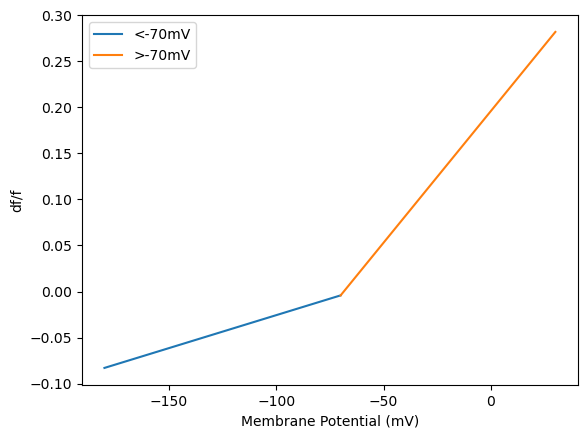

In [6]:
# cells dict maps cell_id to Cell object
# me_type_morphology_map maps me_type to list of Morphology objects
# target populations is a list of me_types to compute signal for
target_population_cells = [
    cells[cell_id] for cell_id in cells 
        if any([t_pop in cells[cell_id].get_me_type() for 
                    t_pop in target_hVOS_populations ]) 
]
 # sparsity sampling implemented here
target_population_cells = [cell for cell in target_population_cells
                                if random.random() < target_sparsity]
optical_readout = {'hVOS': hVOSReadout, 'VSD': VSDReadout}[optical_type]
hvos_readout = optical_readout(target_hVOS_populations, 
                               cells, 
                               me_type_morphology_map,
                               force_overwrite=overwrite_optical_data)
target_dir = data_dir + 'archive/run' + str(run_id) + '/'
hvos_readout.compute_optical_signal(target_dir)
hvos_readout.show_voltage_to_intensity_curve()

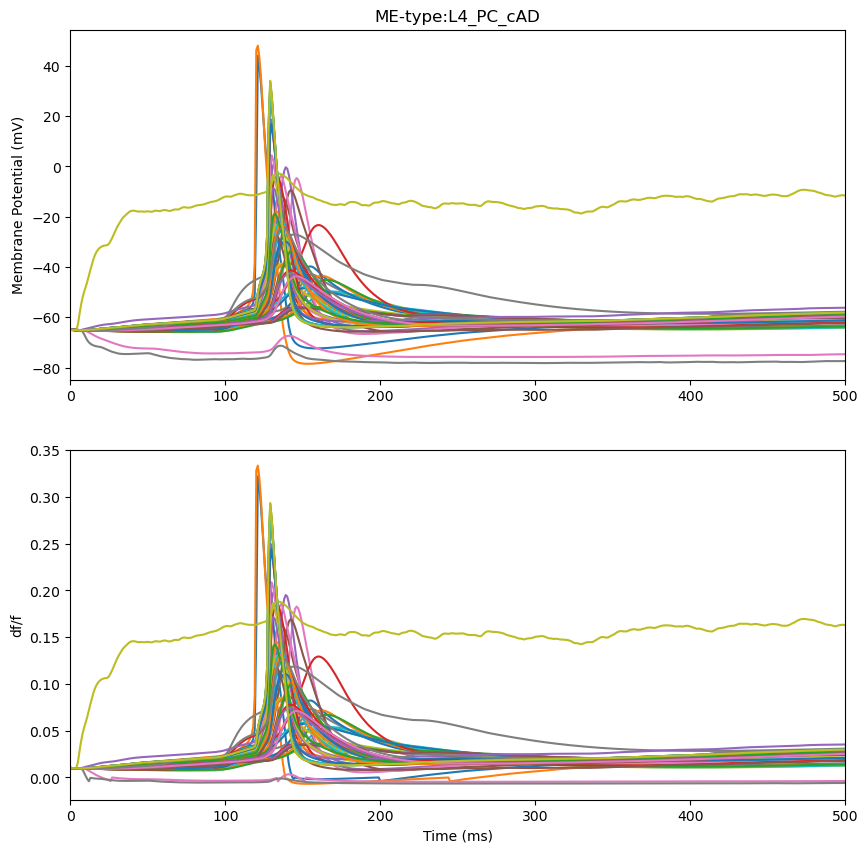

In [7]:
# plot signal, choose random cell

cell = random.choice(target_population_cells)
compart_ids = cell.get_list_compartment_ids()
# make two subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 10))
for compart_id in compart_ids:
    voltage_trace = cell.get_voltage_trace(compart_id)
    intensity_trace = cell.get_optical_trace(compart_id)
    axs[0].plot(voltage_trace, label='Voltage')
    axs[1].plot(intensity_trace, label='Intensity')
axs[1].set_xlabel('Time (ms)')
axs[0].set_ylabel('Membrane Potential (mV)')
axs[1].set_ylabel('df/f')
for ax in axs:
    ax.set_xlim(0, 500)

axs[0].set_title('ME-type:' + cell.get_me_type())

plt.show()

#
#hvos_readout.plot_optical_signal(cell_id)

In [8]:
# determine which morphology to use for each cell
for morph_key in me_type_morphology_map:
    for morph in me_type_morphology_map[morph_key]:
        for cell in target_population_cells:
            if cell.get_me_type() == morph.me_type:

                if morph.does_cell_match_morphology(cell):
                    cell.set_morphology(morph)

print("Any target cells missing structure data?:", 
      any([cell.get_morphology() == None 
           for cell in target_population_cells]))

Any target cells missing structure data?: False


In [29]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import gc
from skimage.measure import block_reduce


class Camera:
    """ A class that draws a camera view of each cell in the network,
     showing the cell's morphology and the intensity of the hVOS signal,
     Then renders frames at every time step to create a video of the 
     network activity seen through the optical traces. """

     # TO DO: render all frames at once cell-by-cell to reduce need for
     #    multiple out-of-bounds checks
     # TO DO: render each compartment as a separate recording array
     # TO DO: store recording in memory-mapped numpy arrays, written to disk after 
     #      each cell so that the file is backed up in case of a crash. 
     # TO DO: CHTC parallelize the render of each cell by writing to disk
    
    def __init__(self, target_cells, morphologies, time, 
                 fov_center=(0, 0, 0),  # um, including axial focus
                 camera_width=80,  # pixels
                 camera_height=80,  # pixels
                 camera_resolution=6.0,  # um/pixel
                 camera_angle='coronal', 
                 psf=None,
                 psf_resolution=1.0, # um/pixel
                 decomposition=None, # 'compartment', 'activity_type', etc
                 data_dir=''  # for storing memory-mapped numpy arrays
                 ):  
        self.target_cells = target_cells
        self.morphologies = morphologies
        self.time = time
        self.fov_center = fov_center  # in um, including axial focus
        self.camera_width = camera_width
        self.camera_height = camera_height
        self.camera_resolution = camera_resolution
        self.camera_angle = camera_angle  # coronal: see all layers in y-z plane
        self.decomposition = decomposition
        self.data_dir = data_dir

        # make self.recordings into memory-mapped numpy arrays.
        self.recordings = None
        if self.decomposition == 'compartment':
            self.recordings = {
                key: np.memmap(self.get_mmap_filename(decomp_type=key), dtype='float32',
                                mode='w+', shape=(len(self.time), self.camera_width, self.camera_height))
                for key in ['soma', 'axon', 'dend', 'apic']
            }
            # zero out the memory-mapped numpy arrays
            for key in self.recordings:
                self.recordings[key][:, :, :] = 0
        elif self.decomposition == 'activity_type':
            self.recordings = {
                key: np.memmap(self.get_mmap_filename(decomp_type=key), dtype='float32',
                                mode='w+', shape=(len(self.time), self.camera_width, self.camera_height))
                for key in ['spiking', 'synaptic']
            }
            # zero out the memory-mapped numpy arrays
            for key in self.recordings:
                self.recordings[key][:, :, :] = 0
        else:
            mm_fp = self.get_mmap_filename(decomp_type=None)
            self.recordings = np.memmap(mm_fp, dtype='float32', mode='w+', shape=(len(self.time), self.camera_width, self.camera_height))
            # zero out the memory-mapped numpy array
            self.recordings[:, :, :] = 0
        self.psf = psf
        self.psf_resolution = psf_resolution  # treat this as the axial resolution as well, which is realistically ~1 um
        self.rescale_psf()
        #self.orient_psf_to_camera()

    def get_mmap_filename(self, decomp_type=None, file_keyword='model_rec'):
        """ Get the filename of the memory-mapped numpy array. """
        cell_ids = [cell.cell_id for cell in self.target_cells]
        if len(cell_ids) > 1:
            cell_id = 'multi' + str(len(cell_ids))
        else:
            cell_id = cell_ids[0]
        if decomp_type is None:
            return self.data_dir + str(cell_id) + '-' + file_keyword + '.npy'
        return self.data_dir + str(cell_id) + '-' + file_keyword + '_' + decomp_type + '.npy'
        
    def rescale_psf(self):
        ''' 
        The PSF is a 3D array, with the center of the PSF at the center of the array.
        Its units are in um, while the camera view is in pixels,
        which is (self.camera_resolution) um per pixel by default.
        So the PSF needs to be rescaled to match the camera view's resolution.
        This is done by downsampling the PSF to the camera view's resolution.
        '''
        if self.psf is None:
            return
        if self.camera_resolution == self.psf_resolution:
            return
        if self.camera_resolution < self.psf_resolution:
            raise ValueError("Camera resolution must be greater than PSF resolution.")
        # downsample the PSF to the camera view's resolution
        # downsample at a factor of (camera_resolution / psf_resolution)
        downsample_factor = int(self.camera_resolution / self.psf_resolution)
        # downsample the PSF along all three dimensions. Use binning to downsample
        # along each dimension.
        self.psf = block_reduce(self.psf, (downsample_factor, downsample_factor, downsample_factor), np.mean)
        # normalize the PSF so that its sum is 1
        self.psf /= np.sum(self.psf)

    def orient_psf_to_camera(self):
        """ Orient the PSF to the camera view. """
        if self.psf is None:
            return
        if self.camera_angle == 'coronal':
            # the camera's x-axis is the same as the PSF's z-axis
            # the camera's y-axis is the same as the PSF's x-axis
            # the camera's z-axis is the same as the PSF's y-axis
            # psf has x-y symmetry
            # so, just swap the z and y axes of the PSF
            self.psf = np.swapaxes(self.psf, 0, 2)
            return
        elif self.camera_angle == 'sagittal':
            raise NotImplementedError("Sagittal view is not implemented.")
        else:
            raise NotImplementedError("Only coronal view is implemented.")

    def get_recording(self, decomp_type=None):
        """ Get the recording of the network activity. """
        if self.decomposition is None:
            return self.recordings
        if decomp_type is None:
            return sum([self.recordings[decomp] for decomp in self.recordings])
        return self.recordings[decomp_type]
    
    def flush_memmaps(self):
        """ Flush the memory-mapped numpy arrays to disk. """
        if self.decomposition is None:
            self.recordings.flush()
        else:
            for key in self.recordings:
                self.recordings[key].flush()

    def draw_single_frame(self, time_step):
        """ Draw the camera view of the network at a single time step. 
            Loop over all segments of compartments of all cells in the target population.
            use the optical trace and PSF to determine which pixels receive 
            illumination from that segment. 
            """
        for cell in self.target_cells:
            self._draw_cell(cell, time_step)

    def draw_all_frames(self):
        """ Draw the camera view of the network at all time steps. 
        Do this efficiently, by rendering all frames at once cell-by-cell,
        so that optical trace only needs to be loaded once per segment,
        and segment position only needs to be calculated once per segment. """
        for cell in self.target_cells:
                self._draw_cell_full_recording(cell)


    def _draw_cell(self, cell, time_step=0):
        """ Draw the camera view of a single cell at a single time step. 
        Returns true if the cell is within the camera view, false otherwise."""
        print("Drawing", cell, "at time step", time_step)
        x_soma, y_soma, z_soma = cell.get_soma_position()
        structure = cell.get_morphology().get_structure()
        is_cell_in_bounds = False
        
        # follow the morphology of the cell, pulling optical trace from each compartment
        # and drawing it on the camera view
        for compartment in structure:
            intensity_value = cell.get_optical_trace("V" + compartment)[time_step]
            for segment_id in structure[compartment]:
                
                # draw the optical trace on the camera view
                is_cell_in_bounds = \
                    self._draw_segment(structure[compartment][segment_id], 
                                   intensity_value,
                                   x_soma, y_soma, z_soma, time_step) \
                    or is_cell_in_bounds
            del intensity_value
            gc.collect()
        del structure
        gc.collect()
        return is_cell_in_bounds

    def _draw_segment(self, segment, intensity_value, x_soma, y_soma, z_soma, t):
        """ draw the segment of the cell on the camera view. 
        Returns true if the segment is within the camera view, false otherwise."""
        x_seg_prox = float(segment['proximal']['x']) + x_soma
        y_seg_prox = float(segment['proximal']['y']) + y_soma
        z_seg_prox = float(segment['proximal']['z']) + z_soma
        diam_seg_prox = float(segment['proximal']['diameter'])
        x_seg_dist = float(segment['distal']['x']) + x_soma
        y_seg_dist = float(segment['distal']['y']) + y_soma
        z_seg_dist = float(segment['distal']['z']) + z_soma
        diam_seg_dist = float(segment['distal']['diameter'])

        # calculate lateral membrane surface area (um^2) of the segment
        # assuming the segment is a conical frustum. 
        # LA = pi * (r1 + r2) * √((r1 - r2)2 + h2)
        height = np.sqrt((x_seg_dist - x_seg_prox) ** 2 +
                         (y_seg_dist - y_seg_prox) ** 2 +
                         (z_seg_dist - z_seg_prox) ** 2)
        area_lateral = np.pi * (diam_seg_prox + diam_seg_dist) * \
                       np.sqrt((diam_seg_prox - diam_seg_dist) ** 2 + height ** 2)

        # if the segment diameters are smaller than the camera resolution (x-y and axial),
        # treat this as a line of light
        resolution = min(self.camera_resolution, self.psf_resolution)
        if diam_seg_prox < resolution and diam_seg_dist < resolution:

            # figure out what fraction of the segment falls into each pixel
            return self._draw_weighted_line(x_seg_prox, y_seg_prox, z_seg_prox,
                                            x_seg_dist, y_seg_dist, z_seg_dist,
                                            intensity_value * area_lateral, t)
        elif x_seg_dist == x_seg_prox and y_seg_dist == y_seg_prox and z_seg_dist == z_seg_prox:
            return self._draw_weighted_sphere(x_seg_prox, y_seg_prox, z_seg_prox, 
                                              max(diam_seg_prox / 2, diam_seg_dist / 2),
                                              intensity_value * area_lateral, t)
            
        else:   
            return self._draw_weighted_frustum(x_seg_prox, y_seg_prox, z_seg_prox,
                                            x_seg_dist, y_seg_dist, z_seg_dist,
                                            diam_seg_prox, diam_seg_dist,
                                            intensity_value * area_lateral, t)
        
    def _draw_weighted_sphere(self, x, y, z, r, weight, t):
        """ Draw a sphere on the camera view of this weight, weighted by weight.
            Determine what fraction of the sphere falls into each pixel.
            """
        # calculate the number of steps needed to approximate the sphere
        step_size = 0.5 # in um
        n_steps = int(np.pi * r * 2 / step_size)

        # parametrize by theta and phi and draw a point at each theta, phi on the sphere surface
        theta = np.linspace(0, 2 * np.pi, n_steps)
        phi = np.linspace(0, np.pi, n_steps)
        is_cell_in_bounds = False

        for th in theta:
            for ph in phi:
                # spherical coordinates
                x1 = x + r * np.sin(ph) * np.cos(th)
                y1 = y + r * np.sin(ph) * np.sin(th)
                z1 = z + r * np.cos(ph)
                is_cell_in_bounds = \
                    self._draw_weighted_point(x1, y1, z1, weight / (n_steps ** 2), t) \
                    or is_cell_in_bounds
        return is_cell_in_bounds

    def get_points_of_circle(self, center, radius, num_points, u, v):
        """ Get the points of a circle in 3D space.
            Args:
                center: the center of the circle
                u, v: the vectors defining the plane of the circle
                radius: the radius of the circle
                num_points: the number of points to sample on the circle
            Returns:
                A list of points on the circle.
        """
        # Generate points
        theta = np.linspace(0, 2 * np.pi, num_points)
        x = center[0] + radius * (np.cos(theta) * u[0] + np.sin(theta) * v[0])
        y = center[1] + radius * (np.cos(theta) * u[1] + np.sin(theta) * v[1])
        z = center[2] + radius * (np.cos(theta) * u[2] + np.sin(theta) * v[2])
        
        points = np.stack([x, y, z], axis=-1)
        return points
        
    def _draw_weighted_frustum(self, x1, y1, z1, x2, y2, z2, d1, d2, weight, t):
        """ Draw a frustum on the camera view of this weight, weighted by weight.
            Determine what fraction of the frustum falls into each pixel.
            
            Just break this up into multiple lines connecting two circles of diameter d1 and d2
            Step around the circumference of the circles and draw lines between the points.
            The step size is 1/3 the camera resolution, so not many lines needed.
            """
        # calculate the number of steps needed to approximate the frustum
        step_size = 0.5  # in um
        vector_between_circles = np.array([x2 - x1, y2 - y1, z2 - z1])
        n_points = int(max(d1, d2) / step_size)

        # Normalize the normal vector
        norm = np.linalg.norm(vector_between_circles) 
        if norm == 0:  # should not happen because this would have been a sphere
            return False
        normal = vector_between_circles / norm

        # Create two orthogonal vectors to the normal
        if normal[0] != 0 or normal[1] != 0:
            temp_vector = np.array([-normal[1], normal[0], 0])
        else:
            temp_vector = np.array([1, 0, 0])

        u = temp_vector / np.linalg.norm(temp_vector)
        v = np.cross(normal, u)

        # the plane that contains the two circles is perpendicular to the vector between them
        circle1_points = self.get_points_of_circle([x1, y1, z1], 
                                                   d1 / 2, 
                                                   n_points,
                                                   u, v)
        circle2_points = self.get_points_of_circle([x2, y2, z2],
                                                   d2 / 2, 
                                                   n_points,
                                                   u, v)
        is_cell_in_bounds = False
        for i_circle in range(len(circle1_points)):
            is_cell_in_bounds = self._draw_weighted_line(circle1_points[i_circle][0], 
                                                         circle1_points[i_circle][1], 
                                                         circle1_points[i_circle][2],
                                                         circle2_points[i_circle][0],
                                                         circle2_points[i_circle][1],
                                                         circle2_points[i_circle][2],
                                                         weight / n_points, t) \
                or is_cell_in_bounds
            
        del circle1_points, circle2_points
        gc.collect()
        return is_cell_in_bounds

    def map_point_to_pixel(self, x, y, z):
        """ Given the 3D coordinates of a point, return the pixel location
            in the camera view. 
            The camera is pointed at self.fov_center, and extends 
                    self.camera_width / 2 * self.camera_resolution
            to the left and right of the center, and 
                    self.camera_height / 2 * self.camera_resolution 
            above and below the center.
            (0, 0) is the top-left corner of the camera view

            """
        if self.camera_angle == 'coronal':
            y_dist_to_center = y - self.fov_center[1]
            z_dist_to_center = z - self.fov_center[2]
            # convert to pixels
            y_dist_to_center /= self.camera_resolution
            z_dist_to_center /= self.camera_resolution
            # invert y because the camera view has y increasing downwards
            y = -y_dist_to_center
            z = z_dist_to_center
            # pixels are centered at (self.camera_width / 2, self.camera_height / 2)
            # i.e. 0, 0 -> 40, 40
            i = int(y + self.camera_width / 2)
            j = int(z + self.camera_height / 2)
            
        elif self.camera_angle == 'sagittal':
            raise NotImplementedError("Sagittal view is not implemented.")
        else:
            raise NotImplementedError("Only coronal view is implemented.")
        return i, j
    
    def bresenham_line(self, x1, y1, x2, y2):
        """
        Draws a line between two points using Bresenham's algorithm.
        Args:
            x1: x-coordinate of the starting point.
            y1: y-coordinate of the starting point.
            x2: x-coordinate of the ending point.
            y2: y-coordinate of the ending point.
        Returns:
            A list of tuples representing the coordinates of the points on the line.
            Includes both the start and end points.
        """
        m_new = 2 * (y2 - y1) 
        slope_error_new = m_new - (x2 - x1) 
        points = []
    
        y = y1 
        for x in range(x1, x2+1): 
    
            points.append((x, y))
  
            # Add slope to increment angle formed 
            slope_error_new = slope_error_new + m_new 
    
            # Slope error reached limit, time to 
            # increment y and update slope error. 
            if (slope_error_new >= 0): 
                y = y+1
                slope_error_new = slope_error_new - 2 * (x2 - x1) 
        return points
  
    def _draw_weighted_line(self, x1, y1, z1, x2, y2, z2, weight, t):
        """ Draw a line on the camera view of this weight, weighted by weight.
            Determine what fraction of the line falls into each pixel."""
        # Bresenham's line algorithm
        is_cell_in_bounds = False
        i_start, j_start = self.map_point_to_pixel(x1, y1, z1)
        i_end, j_end = self.map_point_to_pixel(x2, y2, z2)

        # if the line does not cross any pixels...
        if i_start == i_end and j_start == j_end:
            step_size = 0.5  # in um
            z_dist = np.abs(z2 - z1)
            zv = np.linspace(z1, z2, int(z_dist / step_size)) # ...it might still cross in/out of z-focus
            if len(zv) <= 2:  # ... if it a very short line, treat as one point
                del zv
                gc.collect()
                return self._draw_weighted_point(x1, y1, z1, weight, t, i=i_start, j=j_start)
            for z_inter in zv:  # ... if it is a longer line, chunk into many points
                is_cell_in_bounds = self._draw_weighted_point(x1, y1, z_inter, weight / len(zv), t) \
                    or is_cell_in_bounds
            return is_cell_in_bounds

        # list the pixels that the line passes through (from i_start, j_start to i_end, j_end)
        # https://en.wikipedia.org/wiki/Bresenham%27s_line_algorithm
        pixels = self.bresenham_line(i_start, j_start, i_end, j_end)

        # make an approximation and say that the start and end contain half the weight
        # and the rest of the weight is distributed evenly among the pixels in between
        if len(pixels) <= 2:
            del pixels
            gc.collect()
            r1 = self._draw_weighted_point(x1, y1, z1, weight / 2, t, i=i_start, j=j_start)
            r2 = self._draw_weighted_point(x2, y2, z2, weight / 2, t, i=i_end, j=j_end)
            return r1 or r2
        else:
            weight_per_pixel = weight / (len(pixels) - 1)
            for i_px, pt in enumerate(pixels):
                if i_px == 0 or i_px == len(pixels) - 1:
                    continue
                is_cell_in_bounds = self._draw_weighted_point(x1, y1, z1, weight_per_pixel, t, i=pt[0], j=pt[1]) \
                    or is_cell_in_bounds
                
            del pixels
            gc.collect()
                
            r1 = self._draw_weighted_point(x1, y1, z1, weight_per_pixel / 2, t, i=i_start, j=j_start)
            r2 = self._draw_weighted_point(x2, y2, z2, weight_per_pixel / 2, t, i=i_end, j=j_end)
            return r1 or r2 or is_cell_in_bounds

    def _draw_weighted_point(self, x, y, z, weight, t, i=None, j=None):
        """ Draw a point on the camera view of this weight,
            convolved with the PSF. 
            Returns true if the point is within the camera view, false otherwise."""
        
        if i is None or j is None:
            i, j = self.map_point_to_pixel(x, y, z)
        # print("Drawing point at", i, j, "with weight", weight)
        if self.psf is None:
            if 0 <= i < self.camera_width and 0 <= j < self.camera_height:
                self.record_point_intensity(i, j, weight, t, None)
            return (0 <= i < self.camera_width and 0 <= j < self.camera_height)
        else:
            # paste the PSF in the recording array centered at the point
            # (it was already rescaled to match the camera resolution)
            # make sure the PSF is centered at the point, and that the PSF's depth dimension
            # is the same as the camera view's depth dimension
            
            x_psf_shape, y_psf_shape, z_psf_shape = self.psf.shape
            x_psf_lim = [-x_psf_shape // 2, -x_psf_shape // 2 + x_psf_shape]
            y_psf_lim = [-y_psf_shape // 2, -y_psf_shape // 2 + y_psf_shape]
            z_psf_lim = [-z_psf_shape // 2, -z_psf_shape // 2 + z_psf_shape]

            if i + x_psf_lim[1] < 0:  # the PSF is entirely to the left of the camera view
                return False 
            if i + x_psf_lim[0] > self.camera_width: # the PSF is entirely to the right of the camera view
                return False
            if j + y_psf_lim[1] < 0: # the PSF is entirely above the camera view
                return False
            if j + y_psf_lim[0] > self.camera_height: # the PSF is entirely below the camera view
                return False

            z_fov = self.fov_center[2] / self.camera_resolution

            # if the point z is outside the PSF's z range, return False
            if z < z_fov + z_psf_lim[0] or z > z_fov + z_psf_lim[1]:
                return False
            
            xy_psf_weighted = self.psf[:, :, int(round(z - z_fov))] * weight

            # actual bounds
            i_bounds = [max(0, i + x_psf_lim[0]), min(self.camera_width, i + x_psf_lim[1])]
            j_bounds = [max(0, j + y_psf_lim[0]), min(self.camera_height, j + y_psf_lim[1])]

            # fit xy_psf to match the actual bounds
            if i + x_psf_lim[0] < 0:
                x_psf_lim = [-i, x_psf_lim[1]]
            elif i + x_psf_lim[1] > self.camera_width:
                x_psf_lim = [x_psf_lim[0], self.camera_width - i]
            if j + y_psf_lim[0] < 0:
                y_psf_lim = [-j, y_psf_lim[1]]
            if j + y_psf_lim[1] > self.camera_height:
                y_psf_lim = [y_psf_lim[0], self.camera_height - j]

            x_psf_weighted_bounded = \
                xy_psf_weighted[x_psf_lim[0]-x_psf_lim[0]:x_psf_lim[1]-x_psf_lim[0],
                                y_psf_lim[0]-y_psf_lim[0]:y_psf_lim[1]-y_psf_lim[0]]

            self.record_point_intensity(None, None, x_psf_weighted_bounded, 
                                        t, i_bounds=i_bounds, j_bounds=j_bounds)
            return True            
        
    def record_point_intensity(self, i, j, weights, t, i_bounds=None, j_bounds=None,
                               decomp_type=None):
        """ Record the intensity of a point on the camera view. """
        recording = self.get_recording(decomp_type=decomp_type)

        if i_bounds is None and j_bounds is None:
            recording[t, i, j] += weights
        else:
            recording[t, i_bounds[0]:i_bounds[1], j_bounds[0]:j_bounds[1]] += weights



In [ ]:
#cell = random.choice(target_population_cells)
soma_position = cell.get_soma_position()

cam = Camera(target_population_cells, 
             me_type_morphology_map, 
             loaded_compart_data['time'],
             fov_center=soma_position,
             camera_resolution=1.0,
             psf=None,
             data_dir=modeL_rec_out_dir)
cam._draw_cell(cell, 0)
rec = cam.get_recording()
plt.imshow(rec[0, :, :])
plt.title("Without PSF")
plt.show()

OSError: [Errno 22] Invalid argument: 'multi190-model_rec.npy'

Drawing Cell(id=cell_8544, me_type=L4_PC_cAD, position=94.69577815331071, 761.079468962975, 227.11261899754427) at time step 0


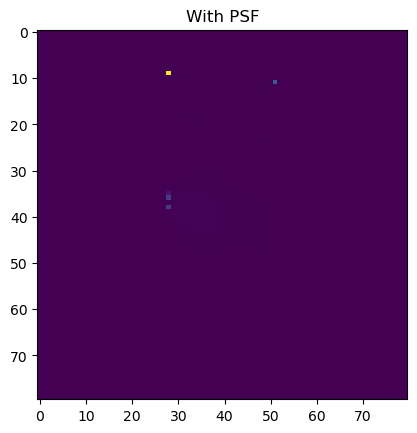

In [ ]:
cam = Camera(target_population_cells, 
             me_type_morphology_map, 
             loaded_compart_data['time'],
             fov_center=soma_position,
             camera_resolution=1.0,
             psf=psf,
             data_dir=modeL_rec_out_dir)
cam._draw_cell(cell, 0)
rec = cam.get_recording()
plt.imshow(rec[0, :, :])
plt.title("With PSF")
plt.show()

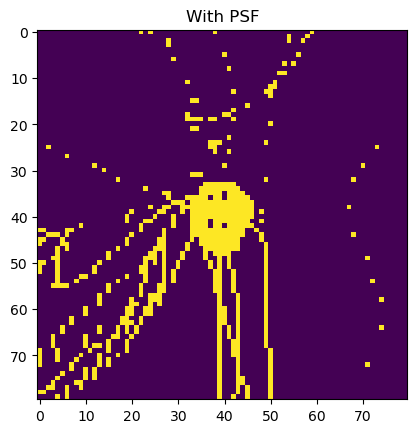

In [ ]:
plt.imshow(rec[0, :, :], vmax=0.001)
plt.title("With PSF")
plt.show()

In [ ]:
print(max(rec[rec > 0]))

1.2823103329266565


In [ ]:
# use Camera class to draw the full network with PSF
'''cam = Camera(target_population_cells, 
             me_type_morphology_map, 
             loaded_compart_data['time'],
             psf=psf, # psf has default resolution of 1 um
             data_dir=modeL_rec_out_dir)  
cam.draw_single_frame(0)
rec = cam.get_reording()
plt.imshow(rec[0])
plt.show()'''

Drawing Cell(id=cell_12112, me_type=L4_SS_cAD, position=361.15608615992466, 795.9354869226404, 131.11651581682264) at time step 0
Drawing point at -90 60 with weight 0.021246774611475356
Drawing point at -91 60 with weight 0.021246774611475356
Drawing point at -90 60 with weight 0.021246774611475356
Drawing point at -91 61 with weight 0.021246774611475356
Drawing point at -90 60 with weight 0.021246774611475356
Drawing point at -91 60 with weight 0.021246774611475356
Drawing point at -91 60 with weight 0.04249354922295071
Drawing point at -90 60 with weight 0.021246774611475356
Drawing point at -91 60 with weight 0.021246774611475356
Drawing point at -91 60 with weight 0.054006280453232594
Drawing point at -91 60 with weight 0.027003140226616297
Drawing point at -91 61 with weight 0.027003140226616297
Drawing point at -91 61 with weight 0.054006280453232594
Drawing point at -91 60 with weight 0.027003140226616297
Drawing point at -91 61 with weight 0.027003140226616297
Drawing point at

KeyboardInterrupt: 